<a href="https://colab.research.google.com/github/XcEland/Predicting-Probability-of-Default/blob/main/defaultModel.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
import pandas as pd
import numpy as np
import plotly.express as px
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
# import ydata_profiling as yp
# from ydata_profiling import ProfileReport
import warnings
warnings.filterwarnings('ignore')
%matplotlib inline

In [2]:
sns.set_style('darkgrid')
matplotlib.rcParams['font.size'] = 14
matplotlib.rcParams['figure.figsize'] = (10, 6)
matplotlib.rcParams['figure.facecolor'] = '#00000000'

In [3]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [19]:
df = pd.read_csv('/content/drive/MyDrive/datasets/data_science_competition_2024.csv')
dataset = df.copy()

In [5]:
dataset.head()

,Unnamed: 0,loan_id,gender,disbursemet_date,currency,country,sex,is_employed,job,location,...,number_of_defaults,outstanding_balance,interest_rate,age,number_of_defaults.1,remaining term,salary,marital_status,age.1,Loan Status
0,0,8d05de78-ff32-46b1-aeb5-b3190f9c158a,female,2022 10 29,USD,Zimbabwe,female,True,Teacher,Beitbridge,...,0,48653.011473,0.22,37,0,47,3230.038869,married,37,Did not default
1,1,368bf756-fcf2-4822-9612-f445d90b485b,other,2020 06 06,USD,Zimbabwe,other,True,Teacher,Harare,...,2,28752.062237,0.20,43,2,62,3194.139103,single,43,Did not default
2,2,6e3be39e-49b5-45b5-aab6-c6556de53c6f,other,2023 09 29,USD,Zimbabwe,other,True,Nurse,Gweru,...,1,44797.554126,0.22,43,1,57,3330.826656,married,43,Did not default
3,3,191c62f8-2211-49fe-ba91-43556b307871,female,2022 06 22,USD,Zimbabwe,female,True,Doctor,Rusape,...,0,35681.496413,0.23,47,0,42,2246.797020,divorced,47,Did not default
4,4,477cd8a1-3b01-4623-9318-8cd6122a8346,male,2023 02 08,USD,Zimbabwe,male,True,Nurse,Chipinge,...,0,34156.055882,0.20,42,0,45,2310.858441,married,42,Did not default


In [ ]:
dataset.describe()

,Unnamed: 0,loan_amount,number_of_defaults,outstanding_balance,interest_rate,age,number_of_defaults.1,salary,age.1
count,100000.000000,100000.000000,100000.000000,100000.000000,100000.000000,100000.00000,100000.000000,100000.000000,100000.00000
mean,49999.500000,31120.000000,0.441970,36964.909763,0.210435,43.57069,0.441970,2781.804324,43.57069
std,28867.657797,15895.093631,0.688286,10014.758477,0.018725,4.86376,0.688286,696.450055,4.86376
min,0.000000,1000.000000,0.000000,0.000000,0.100000,21.00000,0.000000,250.000000,21.00000
25%,24999.750000,21000.000000,0.000000,29625.227472,0.200000,40.00000,0.000000,2273.929349,40.00000
50%,49999.500000,31000.000000,0.000000,35063.852394,0.210000,44.00000,0.000000,2665.441567,44.00000
75%,74999.250000,40000.000000,1.000000,42133.388817,0.220000,47.00000,1.000000,3146.577655,47.00000
max,99999.000000,273000.000000,2.000000,150960.000000,0.300000,65.00000,2.000000,10000.000000,65.00000


In [6]:
dataset.isna().sum()

Unnamed: 0                 0
loan_id                    0
gender                     0
disbursemet_date           0
currency                   0
country                  100
sex                        0
is_employed                0
job                     4136
location                 595
loan_amount                0
number_of_defaults         0
outstanding_balance        0
interest_rate              0
age                        0
number_of_defaults.1       0
remaining term             0
salary                     0
marital_status             0
age.1                      0
Loan Status                0
dtype: int64

In [ ]:
profile = ProfileReport(dataset, title="Profiling Report")

In [ ]:
profile

Summarize dataset:   0%|          | 0/5 [00:00<?, ?it/s]

Generate report structure:   0%|          | 0/1 [00:00<?, ?it/s]

Render HTML:   0%|          | 0/1 [00:00<?, ?it/s]

In [ ]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 100000 entries, 0 to 99999
Data columns (total 21 columns):
 #   Column                Non-Null Count   Dtype  
---  ------                --------------   -----  
 0   Unnamed: 0            100000 non-null  int64  
 1   loan_id               100000 non-null  object 
 2   gender                100000 non-null  object 
 3   disbursemet_date      100000 non-null  object 
 4   currency              100000 non-null  object 
 5   country               99900 non-null   object 
 6   sex                   100000 non-null  object 
 7   is_employed           100000 non-null  bool   
 8   job                   95864 non-null   object 
 9   location              99405 non-null   object 
 10  loan_amount           100000 non-null  float64
 11  number_of_defaults    100000 non-null  int64  
 12  outstanding_balance   100000 non-null  float64
 13  interest_rate         100000 non-null  float64
 14  age                   100000 non-null  int64  
 15  n

In [20]:
unique_jobs = dataset['job'].unique()
print(f"List of different jobs: {unique_jobs}")

List of different jobs: ['Teacher' 'Nurse' 'Doctor' 'Data Analyst' 'Software Developer'
 'Accountant' 'Lawyer' 'Engineer' nan 'Data Scientist' 'SoftwareDeveloper'
 'Data Scintist']


In [21]:
def check_unfilled_jobs(dataset):
    # Find rows where 'job' is NaN or empty
    unfilled_jobs = df['job'].isnull() | (df['job'] == '')

    # Check if 'is-employed' is False for these rows
    incorrect_employment_status = df[unfilled_jobs & df['is_employed']]

    if not incorrect_employment_status.empty:
        return "There are rows with unfilled jobs where 'is-employed' is not False."
    else:
        return "All rows with unfilled jobs have 'is-employed' set to False."

check_unfilled_jobs(dataset)

"All rows with unfilled jobs have 'is-employed' set to False."

In [22]:
dataset['job'].fillna('Unemployed', inplace=True)

In [23]:
dataset['job'] = dataset['job'].replace('SoftwareDeveloper', 'Software Developer')
dataset['job'] = dataset['job'].replace('Data Scintist', 'Data Scientist')

In [24]:
print(f"List of different jobs: {dataset['job'].unique()}")

List of different jobs: ['Teacher' 'Nurse' 'Doctor' 'Data Analyst' 'Software Developer'
 'Accountant' 'Lawyer' 'Engineer' 'Unemployed' 'Data Scientist']


In [25]:
dataset['job']

0             Teacher
1             Teacher
2               Nurse
3              Doctor
4               Nurse
             ...     
99995      Unemployed
99996        Engineer
99997    Data Analyst
99998        Engineer
99999        Engineer
Name: job, Length: 100000, dtype: object

In [26]:
unique_location = dataset['location'].unique()
print("List of different locations:")
for location in unique_location:
    print(location)

List of different locations:
Beitbridge
Harare
Gweru
Rusape
Chipinge
Chimanimani
Marondera
Kadoma
Mutare
Masvingo
Bulawayo
Kariba
Plumtree
Chiredzi
Shurugwi
Chivhu
Zvishavane
Nyanga
Karoi
Redcliff
Kwekwe
 Karoi 
Gokwe
Victoria Falls
 Masvingo 
   Chipinge   
 Mutare 
nan
   Mutare 
 Marondera   
   Rusape   
 Bulawayo   
Chivhu 
 Chimanimani   
Plumtree   
   Masvingo   
   Gweru 
   Chivhu   
Mutare   
 Kwekwe 
Marondera   
 Chipinge   
   Mutare   
   Karoi   
 Beitbridge   
   Karoi 
 Beitbridge 
 Mutare   
   Bulawayo 
Masvingo   
 Kadoma   
 Plumtree 
Marondera 
   Plumtree 
 Chipinge 
   Harare 
Harare   
 Nyanga   
 Gweru   
Rusape   
Masvingo 
   Harare   
 Kadoma 
Bulawayo   
 Kwekwe   
Hwange
 Harare 
   Marondera   
Chipinge   
   Marondera 
   Beitbridge 
Karoi   
Chimanimani 
 Bulawayo 
Chivhu   
Kwekwe 
 Kariba   
 Marondera 
Plumtree 
   Bulawayo   
Karoi 
 Chivhu   
   Nyanga 
   Chipinge 
 Rusape   
   Beitbridge   
 Harare   
 Chivhu 
 Gweru 
 Kariba 
Harare 
 Chimani

In [27]:
# Drop rows where 'location' is null or NaN
dataset.dropna(subset=['location'], inplace=True)

In [123]:
# Strip leading/trailing spaces and convert to lowercase
dataset['location'] = dataset['location'].str.strip().str.lower().str.title()
# dataset['location'] = dataset['location'].str.title()
# Get unique city names
# unique_locations = dataset['location'].unique()

# Print the list of cleaned unique locations
# print("List of different locations:")
# for location in unique_locations:
#     print(location)

# Get the count of each unique city
city_counts = dataset['location'].value_counts()

# Print the number of unique cities
num_unique_cities = city_counts.size
print(f"Number of different locations: {num_unique_cities}")

AttributeError: Can only use .str accessor with string values!

In [ ]:
# Print the list of unique cities and their counts
print("List of different locations and their counts:")
for city, count in city_counts.items():
    print(f"{city}: {count}")

In [29]:

dataset.info()

<class 'pandas.core.frame.DataFrame'>
Index: 99405 entries, 0 to 99999
Data columns (total 21 columns):
 #   Column                Non-Null Count  Dtype  
---  ------                --------------  -----  
 0   Unnamed: 0            99405 non-null  int64  
 1   loan_id               99405 non-null  object 
 2   gender                99405 non-null  object 
 3   disbursemet_date      99405 non-null  object 
 4   currency              99405 non-null  object 
 5   country               99306 non-null  object 
 6   sex                   99405 non-null  object 
 7   is_employed           99405 non-null  bool   
 8   job                   99405 non-null  object 
 9   location              99405 non-null  object 
 10  loan_amount           99405 non-null  float64
 11  number_of_defaults    99405 non-null  int64  
 12  outstanding_balance   99405 non-null  float64
 13  interest_rate         99405 non-null  float64
 14  age                   99405 non-null  int64  
 15  number_of_defaults.1  99

# drop unnecessary features

In [30]:
dataset.drop(columns=['Unnamed: 0','loan_id','currency','sex','country','age.1','number_of_defaults.1' ], inplace=True)

In [31]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
Index: 99405 entries, 0 to 99999
Data columns (total 14 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   gender               99405 non-null  object 
 1   disbursemet_date     99405 non-null  object 
 2   is_employed          99405 non-null  bool   
 3   job                  99405 non-null  object 
 4   location             99405 non-null  object 
 5   loan_amount          99405 non-null  float64
 6   number_of_defaults   99405 non-null  int64  
 7   outstanding_balance  99405 non-null  float64
 8   interest_rate        99405 non-null  float64
 9   age                  99405 non-null  int64  
 10  remaining term       99405 non-null  object 
 11  salary               99405 non-null  float64
 12  marital_status       99405 non-null  object 
 13  Loan Status          99405 non-null  object 
dtypes: bool(1), float64(4), int64(2), object(7)
memory usage: 10.7+ MB


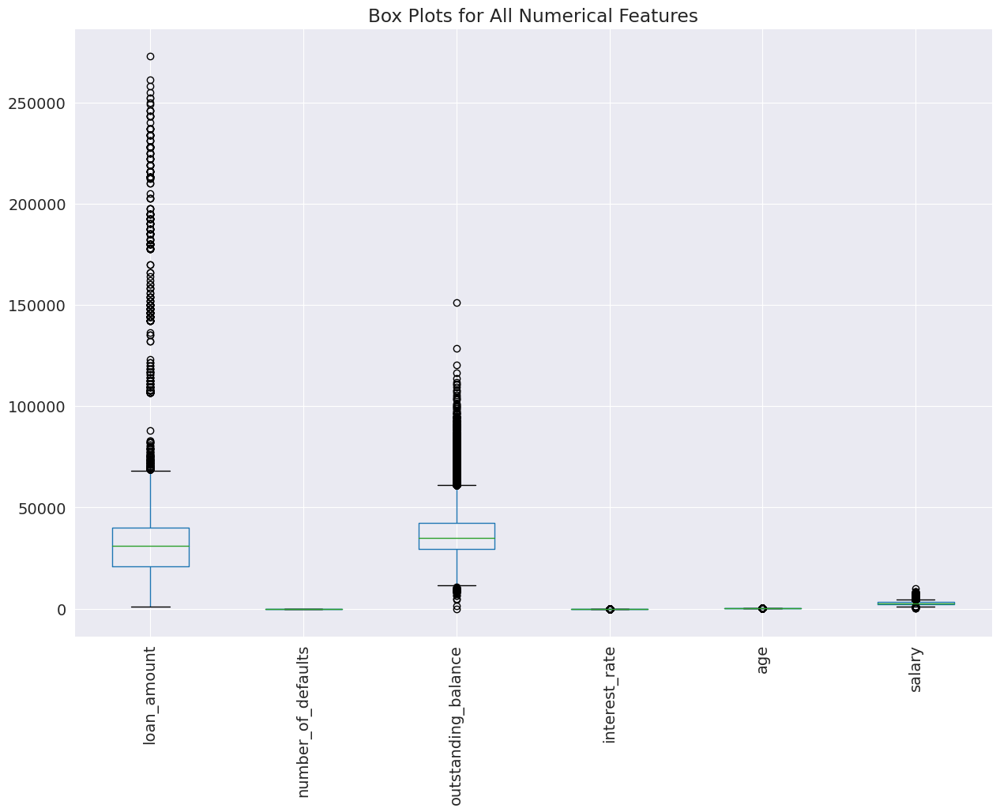

In [32]:
def boxplotter(dataset):
  numerical_features = dataset.select_dtypes(include=[float, int])
  # Create box plots for all numerical features
  plt.figure(figsize=(15, 10))  # Adjust the figure size as needed
  numerical_features.boxplot()
  plt.xticks(rotation=90)  # Rotate x-axis labels if they overlap
  plt.title('Box Plots for All Numerical Features')
  plt.show()

boxplotter(dataset)

In [33]:
def remove_outliers(dataset):
    numerical_features = dataset.select_dtypes(include=[float, int])
    for feature in numerical_features:
        # Calculate the quartiles
        Q1 = dataset[feature].quantile(0.25)
        Q3 = dataset[feature].quantile(0.75)
        IQR = Q3 - Q1

        # Determine the bounds
        lower_bound = Q1 - 1.5 * IQR
        upper_bound = Q3 + 1.5 * IQR

        # Drop the outliers
        dataset = dataset[(dataset[feature] >= lower_bound) & (dataset[feature] <= upper_bound)]

    return dataset

In [34]:
# Remove outliers
dataset = remove_outliers(dataset)

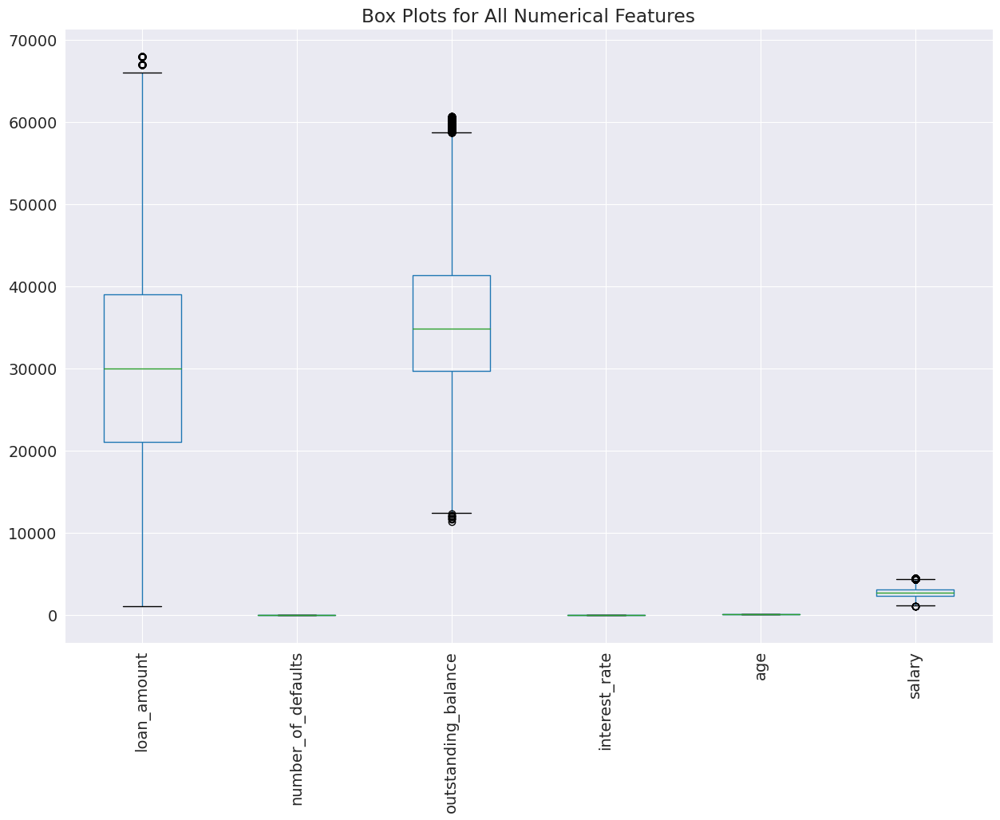

In [35]:
boxplotter(dataset)

In [36]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
Index: 88565 entries, 0 to 99999
Data columns (total 14 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   gender               88565 non-null  object 
 1   disbursemet_date     88565 non-null  object 
 2   is_employed          88565 non-null  bool   
 3   job                  88565 non-null  object 
 4   location             88565 non-null  object 
 5   loan_amount          88565 non-null  float64
 6   number_of_defaults   88565 non-null  int64  
 7   outstanding_balance  88565 non-null  float64
 8   interest_rate        88565 non-null  float64
 9   age                  88565 non-null  int64  
 10  remaining term       88565 non-null  object 
 11  salary               88565 non-null  float64
 12  marital_status       88565 non-null  object 
 13  Loan Status          88565 non-null  object 
dtypes: bool(1), float64(4), int64(2), object(7)
memory usage: 9.5+ MB


# Filling Missing values

In [60]:
unique_marital_status_counts = dataset['marital_status'].value_counts()

# Print the counts of unique values
print("Counts of unique values for 'marital status':")
print(unique_marital_status_counts)

Counts of unique values for 'marital status':
marital_status
married     40588
divorced    22856
single      22324
Name: count, dtype: int64


In [59]:
dataset['marital_status'] = dataset['marital_status'].str.strip()
# Drop rows where 'marital_status' is empty or NaN
dataset = dataset[dataset['marital_status'] != '']
dataset = dataset.dropna(subset=['marital_status'])
dataset.reset_index(drop=True, inplace=True)

In [ ]:
print("Counts of unique values for 'marital status':")
print(dataset['marital_status'].value_counts())

In [61]:
dataset['remaining term'] = dataset['remaining term'].astype(str).str.replace('_', '').str.replace(' ', '').astype(int)

In [62]:
print(dataset['remaining term'].head())

0    47
1    62
2    57
3    42
4    45
Name: remaining term, dtype: int64


In [ ]:
# Check if 'age' and 'age.1' columns are duplicates
if 'age' in dataset.columns and 'age.1' in dataset.columns:
    are_duplicates = dataset['age'].equals(dataset['age.1'])
    if are_duplicates:
        print("The columns 'age' and 'age.1' are duplicates.")
    else:
        print("The columns 'age' and 'age.1' are not duplicates.")

In [ ]:
# Check if 'age' and 'age.1' columns are duplicates
if 'number_of_defaults' in dataset.columns and 'number_of_defaults.1' in dataset.columns:
    are_duplicates = dataset['age'].equals(dataset['age.1'])
    if are_duplicates:
        print("The columns 'age' and 'age.1' are duplicates.")
    else:
        print("The columns 'age' and 'age.1' are not duplicates.")

In [ ]:
#correlation matrix
plt.figure(figsize=(12,10))
sns.heatmap(dataset.corr(numeric_only=True), cmap='Reds', annot=True)
plt.title('Correlation Matrix')
plt.show()

# Exploratory Data Analysis and Visualization
Before training a machine learning model, its always a good idea to explore the distributions of various columns and see how they are related to the target column. Let's explore and visualize the data using the Plotly, Matplotlib and Seaborn libraries

In [63]:
features = dataset.columns
# Generate histograms for all features
for feature in features:
    if feature != 'Loan Status':
        fig = px.histogram(dataset,
                           x=feature,
                           title=f'Loan Default vs. {feature}',
                           color='Loan Status')
        fig.show()

In [64]:
for feature in features:
    if feature != 'Loan Status':
        fig = px.histogram(df,
                           x=feature,
                           title=f'Loan Default vs. {feature}',
                           color='Loan Status',
                           histnorm='percent',  # Normalize the histogram to show percentages
                           barmode='group')     # Group bars for better comparison
        fig.show()

In [41]:
px.scatter(dataset.sample(2000),
           title='Loan Status vs Outstanding Balance',
           x='salary',
           y='outstanding_balance',
           color='Loan Status')

In [81]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 85768 entries, 0 to 85767
Data columns (total 13 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   gender               85768 non-null  int64  
 1   is_employed          85768 non-null  int64  
 2   job                  85768 non-null  int64  
 3   location             85768 non-null  int64  
 4   loan_amount          85768 non-null  float64
 5   number_of_defaults   85768 non-null  int64  
 6   outstanding_balance  85768 non-null  float64
 7   interest_rate        85768 non-null  float64
 8   age                  85768 non-null  int64  
 9   remaining term       85768 non-null  int64  
 10  salary               85768 non-null  float64
 11  marital_status       85768 non-null  int64  
 12  Loan Status          85768 non-null  int64  
dtypes: float64(4), int64(9)
memory usage: 8.5 MB


In [80]:
dataset.drop(columns=['disbursemet_date' ], inplace=True)

# Categorical Data

In [102]:
from sklearn.preprocessing import LabelEncoder

In [104]:
# Features to be label encoded
# categorical_features = ['marital_status', 'is_employed', 'gender', 'job', 'Loan Status', 'location']

In [119]:
# label encoding function
def label_encode_features(dataset, feature):
  dataset[feature] = LabelEncoder().fit_transform(dataset[feature])

  return dataset, LabelEncoder()

In [120]:
dataset, label_encoder = label_encode_features(dataset, 'Loan Status')
print(label_encoder.inverse_transform([0, 1]))

In [122]:
dataset, label_encoder = label_encode_features(dataset, 'marital_status')
print(label_encoder.inverse_transform([0, 1,2]))

NotFittedError: This LabelEncoder instance is not fitted yet. Call 'fit' with appropriate arguments before using this estimator.

In [ ]:
dataset, label_encoder = label_encode_features(dataset, 'is_employed')
print(label_encoder.inverse_transform([0, 1]))

In [ ]:
dataset, label_encoder = label_encode_features(dataset, 'gender')
print(label_encoder.inverse_transform([0, 1, 2]))

In [ ]:
dataset, label_encoder = label_encode_features(dataset, 'job')
print(label_encoder.inverse_transform([0, 1, 2, 3, 4, 5, 6, 7, 8, 9]))

In [ ]:
dataset, label_encoder = label_encode_features(dataset, 'location')
print(label_encoder.inverse_transform([0, 1, 2, 3, 4, 5, 6, 7, 8, 9,10,11,12,13,14,15,16,17,18,19,20]))

In [87]:
dataset

,gender,is_employed,job,location,loan_amount,number_of_defaults,outstanding_balance,interest_rate,age,remaining term,salary,marital_status,Loan Status
0,0,1,8,0,39000.0,0,48653.011473,0.22,37,47,3230.038869,1,1
1,2,1,8,8,27000.0,2,28752.062237,0.20,43,62,3194.139103,2,1
2,2,1,6,7,35000.0,1,44797.554126,0.22,43,57,3330.826656,1,1
3,0,1,3,20,24000.0,0,35681.496413,0.23,47,42,2246.797020,0,1
4,1,1,6,3,19000.0,0,34156.055882,0.20,42,45,2310.858441,1,1
...,...,...,...,...,...,...,...,...,...,...,...,...,...
85763,1,1,8,0,52000.0,0,44720.871567,0.21,41,33,2048.664042,1,1
85764,1,0,9,14,36000.0,1,32968.219881,0.21,52,29,1803.818844,2,1
85765,2,1,4,2,43000.0,0,48652.554897,0.23,50,57,3056.127917,1,1
85766,0,1,1,10,48000.0,0,34266.224130,0.23,43,53,3535.599759,1,1


In [124]:
dataset.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 85768 entries, 0 to 85767
Data columns (total 13 columns):
 #   Column               Non-Null Count  Dtype  
---  ------               --------------  -----  
 0   gender               85768 non-null  int64  
 1   is_employed          85768 non-null  int64  
 2   job                  85768 non-null  int64  
 3   location             85768 non-null  int64  
 4   loan_amount          85768 non-null  float64
 5   number_of_defaults   85768 non-null  int64  
 6   outstanding_balance  85768 non-null  float64
 7   interest_rate        85768 non-null  float64
 8   age                  85768 non-null  int64  
 9   remaining term       85768 non-null  int64  
 10  salary               85768 non-null  float64
 11  marital_status       85768 non-null  int64  
 12  Loan Status          85768 non-null  int64  
dtypes: float64(4), int64(9)
memory usage: 8.5 MB


## Splitting the dataset into the Training set and Test set

In [125]:
X = dataset.drop(columns=['Loan Status']).values
y = y = dataset['Loan Status'].values

In [126]:
X

array([[0.00000000e+00, 1.00000000e+00, 8.00000000e+00, ...,
        4.70000000e+01, 3.23003887e+03, 1.00000000e+00],
       [2.00000000e+00, 1.00000000e+00, 8.00000000e+00, ...,
        6.20000000e+01, 3.19413910e+03, 2.00000000e+00],
       [2.00000000e+00, 1.00000000e+00, 6.00000000e+00, ...,
        5.70000000e+01, 3.33082666e+03, 1.00000000e+00],
       ...,
       [2.00000000e+00, 1.00000000e+00, 4.00000000e+00, ...,
        5.70000000e+01, 3.05612792e+03, 1.00000000e+00],
       [0.00000000e+00, 1.00000000e+00, 1.00000000e+00, ...,
        5.30000000e+01, 3.53559976e+03, 1.00000000e+00],
       [2.00000000e+00, 1.00000000e+00, 4.00000000e+00, ...,
        4.70000000e+01, 2.67076653e+03, 1.00000000e+00]])

In [128]:
from sklearn.model_selection import train_test_split
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size = 0.25, random_state = 0)

In [129]:
print('X.shape :', X.shape)
print('X_train.shape :', X_train.shape)
print('y_train.shape :', y_train.shape)
print('X_test.shape :', X_test.shape)
print('y_test.shape :', y_test.shape)

X.shape : (85768, 12)
X_train.shape : (64326, 12)
y_train.shape : (64326,)
X_test.shape : (21442, 12)
y_test.shape : (21442,)


## Feature Scaling

In [142]:
from sklearn.preprocessing import StandardScaler
scaler = StandardScaler()
X_train = scaler.fit_transform(X_train)
X_test = scaler.transform(X_test)

In [143]:
from sklearn.linear_model import LogisticRegression
log_reg = LogisticRegression(max_iter=10000)
log_reg.fit(X_train, y_train)

LogisticRegression(max_iter=10000)

In [145]:
from sklearn.svm import SVC
svm = SVC(probability=True)
svm.fit(X_train, y_train)

SVC(probability=True)

In [147]:
from sklearn.metrics import roc_curve, auc, roc_auc_score, accuracy_score, precision_score, recall_score, f1_score

In [146]:
# Predict probabilities for the test set
y_pred_prob_log_reg = log_reg.predict_proba(X_test)[:, 1]
y_pred_prob_svm = svm.predict_proba(X_test)[:, 1]

In [148]:
# Compute ROC curve and ROC-AUC for Logistic Regression
fpr_log_reg, tpr_log_reg, _ = roc_curve(y_test, y_pred_prob_log_reg)
roc_auc_log_reg = auc(fpr_log_reg, tpr_log_reg)

In [149]:
# Compute ROC curve and ROC-AUC for SVM
fpr_svm, tpr_svm, _ = roc_curve(y_test, y_pred_prob_svm)
roc_auc_svm = auc(fpr_svm, tpr_svm)

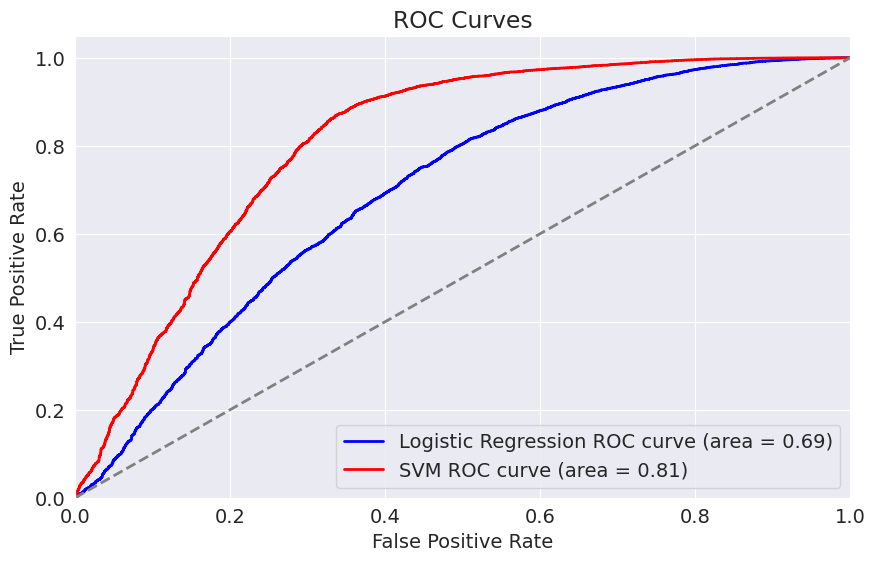

In [150]:
# Plot ROC curves
plt.figure()
plt.plot(fpr_log_reg, tpr_log_reg, color='blue', lw=2, label=f'Logistic Regression ROC curve (area = {roc_auc_log_reg:.2f})')
plt.plot(fpr_svm, tpr_svm, color='red', lw=2, label=f'SVM ROC curve (area = {roc_auc_svm:.2f})')
plt.plot([0, 1], [0, 1], color='grey', lw=2, linestyle='--')
plt.xlim([0.0, 1.0])
plt.ylim([0.0, 1.05])
plt.xlabel('False Positive Rate')
plt.ylabel('True Positive Rate')
plt.title('ROC Curves')
plt.legend(loc="lower right")
plt.show()

In [151]:
# Print AUC scores
print(f'Logistic Regression AUC: {roc_auc_log_reg:.2f}')
print(f'SVM AUC: {roc_auc_svm:.2f}')

Logistic Regression AUC: 0.69
SVM AUC: 0.81


In [155]:
y_pred_log_reg = log_reg.predict(X_test)
y_pred_svm = svm.predict(X_test)

In [156]:
# Compute and print other evaluation metrics for Logistic Regression
accuracy_log_reg = accuracy_score(y_test, y_pred_log_reg)
precision_log_reg = precision_score(y_test, y_pred_log_reg)
recall_log_reg = recall_score(y_test, y_pred_log_reg)
f1_log_reg = f1_score(y_test, y_pred_log_reg)

print(f'Logistic Regression Accuracy: {accuracy_log_reg:.2f}')
print(f'Logistic Regression Precision: {precision_log_reg:.2f}')
print(f'Logistic Regression Recall: {recall_log_reg:.2f}')
print(f'Logistic Regression F1 Score: {f1_log_reg:.2f}')

Logistic Regression Accuracy: 0.88
Logistic Regression Precision: 0.88
Logistic Regression Recall: 1.00
Logistic Regression F1 Score: 0.94


In [157]:
# Compute and print other evaluation metrics for SVM
accuracy_svm = accuracy_score(y_test, y_pred_svm)
precision_svm = precision_score(y_test, y_pred_svm)
recall_svm = recall_score(y_test, y_pred_svm)
f1_svm = f1_score(y_test, y_pred_svm)

print(f'SVM Accuracy: {accuracy_svm:.2f}')
print(f'SVM Precision: {precision_svm:.2f}')
print(f'SVM Recall: {recall_svm:.2f}')
print(f'SVM F1 Score: {f1_svm:.2f}')

SVM Accuracy: 0.90
SVM Precision: 0.90
SVM Recall: 1.00
SVM F1 Score: 0.94


In [159]:
from sklearn.inspection import permutation_importance

perm_importance = permutation_importance(svm, X_test, y_test)
print("SVM  permutation feature importances:")
for idx, importance in enumerate(perm_importance.importances_mean):
    print(f"Feature {idx}: {importance}")

SVM  permutation feature importances:
Feature 0: 0.0029288312657401285
Feature 1: 0.006006902341199494
Feature 2: 0.001259210894506113
Feature 3: 0.00017722227404157743
Feature 4: 0.009224885738270672
Feature 5: 0.0014084507042253502
Feature 6: 0.0012778658707210066
Feature 7: 0.023980971924260807
Feature 8: 0.014905325995709373
Feature 9: 0.034772875664583515
Feature 10: 0.039623169480458895
Feature 11: 0.007592575319466466


## Making Predictions and Evaluating the Model

We can now use the trained model to make predictions on the training, test

In [141]:
from sklearn.metrics import roc_curve, roc_auc_score, auc

In [132]:
print(classifier.coef_.tolist())

[[-0.04517902419586489, 0.08416628880573386, -0.057555609638572085, -0.13615874391338928, -0.1835457828616388, -0.36501155550976255, 0.01423004181329555, 0.36207672143571046, 0.30980518453642586, -0.5015354739218166, 0.669263405811194, 0.30398069611726275]]


In [133]:
classifier.classes_

array([0, 1])

In [134]:
train_preds = classifier.predict(X_train)
print(np.concatenate((train_preds.reshape(len(train_preds),1), y_train.reshape(len(y_train),1)),1))

[[1 1]
 [1 1]
 [1 1]
 ...
 [1 1]
 [1 1]
 [1 0]]


In [136]:
from sklearn.metrics import confusion_matrix, accuracy_score
cm = confusion_matrix(y_train, train_preds)
print(cm)
accuracy_score(y_train, train_preds)

[[  432  7636]
 [  106 56152]]


0.8796443117868358

In [137]:
train_probs = classifier.predict_proba(X_train)
train_probs

array([[0.10247528, 0.89752472],
       [0.21813162, 0.78186838],
       [0.11085195, 0.88914805],
       ...,
       [0.126463  , 0.873537  ],
       [0.15524557, 0.84475443],
       [0.2109309 , 0.7890691 ]])

In [138]:
def predict_and_plot(inputs, targets, name=''):
    preds = classifier.predict(inputs)

    accuracy = accuracy_score(targets, preds)
    print("Accuracy: {:.2f}%".format(accuracy * 100))

    cf = confusion_matrix(targets, preds, normalize='true')
    plt.figure()
    sns.heatmap(cf, annot=True)
    plt.xlabel('Prediction')
    plt.ylabel('Target')
    plt.title('{} Confusion Matrix'.format(name));

    return preds

Accuracy: 87.96%


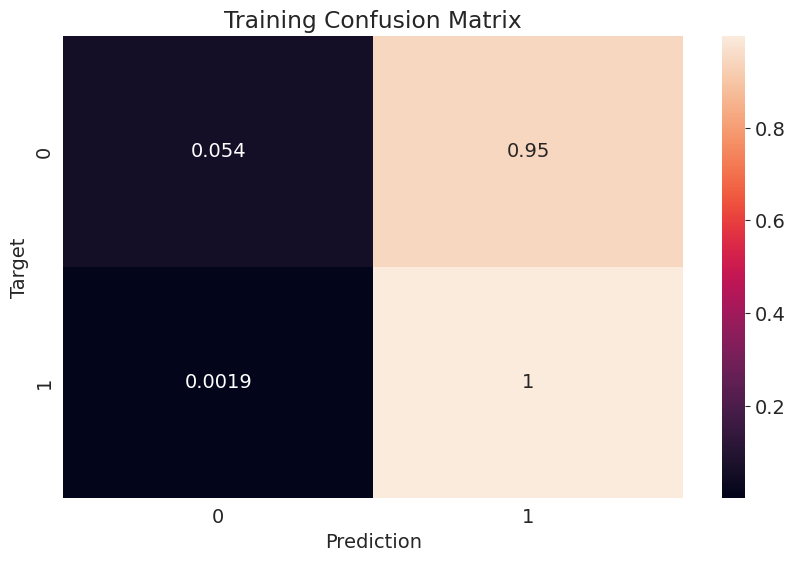

In [139]:
train_preds = predict_and_plot(X_train, y_train, 'Training')

Accuracy: 88.06%


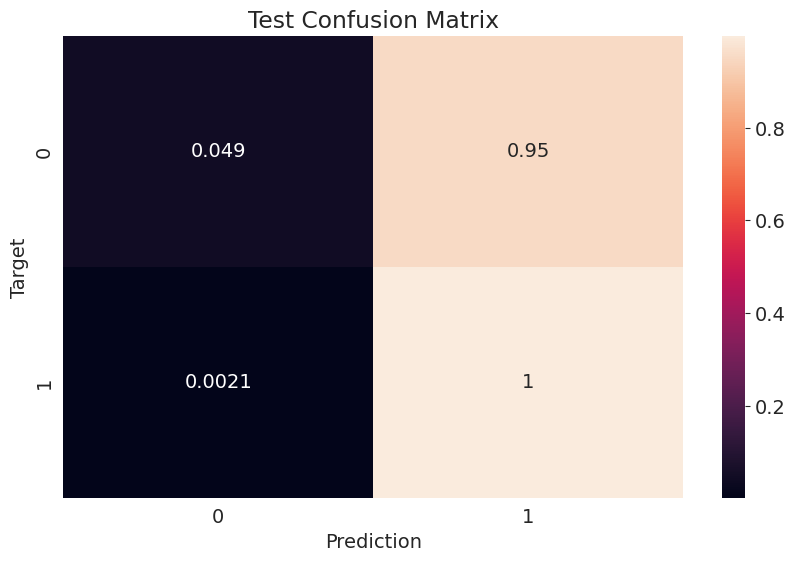

In [140]:
test_preds = predict_and_plot(X_test, y_test, 'Test')